# Group Assignment: Machine Learning 2 - Team 2

## Tabular Classification with an Employee Attrition Dataset

This group assingment is based on the kaggle competition: [*Playground Series Season 3, Episode 3*](https://www.kaggle.com/competitions/playground-series-s3e3). The dataset  was generated from a deep learning model trained on a  generated by [IBM](https://www.kaggle.com/datasets/pavansubhasht/ibm-hr-analytics-attrition-dataset).

The orignal data set was used to uncover the factors that lead to employee attrition and explore important questions such as ‘show me a breakdown of distance from home by job role and attrition’ or ‘compare average monthly income by education and attrition’. This is a fictional data set created by IBM data scientists.

### Team Members

    1. Federico Cañadas
    2. Lutholwethu Dubala
    3. Lia Dollison
    4. Jesus Fuster
    5. Paulino Herrera
    6. Johnny Naime
    7. Andrea Palomino
    8. Sergio Reyes


* [1 Libraries](#Libraries)</n>

* [2 Reading Data](#Reading-Data)</n>

* [3 EDA](#EDA) </n>

* [4 Insights](#Insights)</n>

* [5 Pre processing](#Pre-Processing)</n>
    
* [6 Feauture Engineering](#Feauture-Engineering)</n>

* [7 Modeling of the Data](#Modeling-of-the-Data)</n>

* [8 Submission Set](#Submission-Set)</n>


## 1 Libraries <a class="anchor" id="Libraries"></a>

The following shows the libraries used to perform the analysis of the data and building of the model

In [1]:
#pip install plotnine  

In [2]:
#Libraries for reading and manipulating data
import pandas as pd
pd.set_option('display.max_columns', None)
import numpy as np

#Library to obtain a report per variable
from pandas_profiling import ProfileReport


#Libraries for perfomring Machine Learning Modeling
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import OneHotEncoder 
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV

#Metrcis to evaluate the models
from sklearn.metrics import (
    accuracy_score, 
    precision_score, 
    recall_score, 
    confusion_matrix,
    roc_curve,
    auc,
    mean_squared_error,
    roc_auc_score,
    classification_report
)

#Selected Models to peformence
from xgboost import XGBClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn import tree, ensemble
from sklearn.svm import SVC

#Libraries for performing graphics and visualizations
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
from plotnine import *
import plotnine

# To visualize the impportance of the features of the random forest
import dtreeviz as dtv

#Libraries for Profile Clustering
from tqdm import tqdm
from sklearn.cluster import KMeans

## 2 Reading Data <a class="anchor" id="Reading-Data"></a>

In [3]:
#Reading the training data set
train = pd.read_csv('train.csv')

In [4]:
#Understanding the shape of the training set.
train.shape

(1677, 35)

The first step we are going to take is trying understand the type of variables we are dealing with in the dataset. This allows us to understand if some variables need to be changed to specific type in order to preprocess it later.

In [5]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1677 entries, 0 to 1676
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   id                        1677 non-null   int64 
 1   Age                       1677 non-null   int64 
 2   BusinessTravel            1677 non-null   object
 3   DailyRate                 1677 non-null   int64 
 4   Department                1677 non-null   object
 5   DistanceFromHome          1677 non-null   int64 
 6   Education                 1677 non-null   int64 
 7   EducationField            1677 non-null   object
 8   EmployeeCount             1677 non-null   int64 
 9   EnvironmentSatisfaction   1677 non-null   int64 
 10  Gender                    1677 non-null   object
 11  HourlyRate                1677 non-null   int64 
 12  JobInvolvement            1677 non-null   int64 
 13  JobLevel                  1677 non-null   int64 
 14  JobRole                 

After this we have detected that the following variables needs a transformation since these are not int and need to be treated as categorical values: 
- *Education*
- *EnvironmentSatisfaction* 
- *JobInvolvement* 
- *JobSatisfaction* 
- *PerformanceRating* 
- *StockOptionLevel*
- *RelationshipSatisfaction*
- *WorkLifeBalance*

In [6]:
train.describe().T

,count,mean,std,min,25%,50%,75%,max
id,1677.0,838.000000,484.252517,0.0,419.0,838.0,1257.0,1676.0
Age,1677.0,36.036971,8.507112,18.0,30.0,35.0,41.0,60.0
DailyRate,1677.0,892.749553,374.496259,107.0,589.0,890.0,1223.0,3921.0
DistanceFromHome,1677.0,8.683959,7.826143,1.0,2.0,7.0,12.0,29.0
Education,1677.0,2.937984,1.039078,1.0,2.0,3.0,4.0,15.0
EmployeeCount,1677.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0
EnvironmentSatisfaction,1677.0,2.757901,1.086835,1.0,2.0,3.0,4.0,4.0
HourlyRate,1677.0,67.798450,19.435928,30.0,51.0,69.0,84.0,100.0
JobInvolvement,1677.0,2.782349,0.650664,1.0,2.0,3.0,3.0,4.0
JobLevel,1677.0,1.998807,1.083065,1.0,1.0,2.0,2.0,7.0


## 3 EDA <a class="anchor" id="EDA"></a>

Understanding the level of attrition of the dataset.

In [7]:
Attrition = train['Attrition'].sum()/len(train)
print(f'The Attrition level inside of the dataset is %.2f%%' % (Attrition*100) )

The Attrition level inside of the dataset is 11.93%


### Profile Reporting

In order to understand the first insights of the variables we are going to use the profile reporting.

In [8]:
report = ProfileReport(train)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 4 Insights <a class="anchor" id="Insights"></a>

In [9]:
total = len(train)
career_advancement = len(train[(train['JobLevel'] == 1) & (train['Attrition'] == 1)]) / len(train[train['Attrition'] == 1])
work_life_balance = len(train[train['WorkLifeBalance'] == 1]) / total
low_salary_benefits = len(train[train['MonthlyIncome'] <= train['MonthlyIncome'].mean()]) / total
culture_values = len(train[train['JobRole'] == 'Sales Executive']) / total
poor_management = len(train[train['JobSatisfaction'] <= 2]) / total
limited_job_satisfaction = len(train[train['JobSatisfaction'] <= 2]) / total
undervalued_unappreciated = len(train[train['EnvironmentSatisfaction'] <= 2]) / total
relocation_commute = len(train[train['DistanceFromHome'] >= 15]) / total
personal_family_reasons = len(train[train['MaritalStatus'].isin(['Married', 'Single'])]) / total
health_concerns = len(train[train['Age'] >= 50]) / total

print("Lack of career advancement opportunities: ", career_advancement)
print("Poor work-life balance: ", work_life_balance)
print("Low salary or inadequate benefits: ", low_salary_benefits)
print("Unhappy with company culture or values: ", culture_values)
print("Poor management or leadership: ", poor_management)
print("Limited job satisfaction: ", limited_job_satisfaction)
print("Feeling undervalued or unappreciated: ", undervalued_unappreciated)
print("Relocation or commuting issues: ", relocation_commute)
print("Personal or family reasons: ", personal_family_reasons)
print("Health concerns: ", health_concerns)

Lack of career advancement opportunities:  0.635
Poor work-life balance:  0.04054859868813357
Low salary or inadequate benefits:  0.6708407871198568
Unhappy with company culture or values:  0.2116875372689326
Poor management or leadership:  0.35778175313059035
Limited job satisfaction:  0.35778175313059035
Feeling undervalued or unappreciated:  0.3840190816935003
Relocation or commuting issues:  0.21943947525342875
Personal or family reasons:  0.8050089445438283
Health concerns:  0.08109719737626714


In [10]:
# measured by the ratio of the number of employees who have been promoted in the last 5 years to the total number of employees
promoted_employees = train[train['YearsSinceLastPromotion'] <= 3]['YearsSinceLastPromotion'].count()
total_employees = train['YearsSinceLastPromotion'].count()
career_growth_ratio = promoted_employees / total_employees * 100

# average monthly income to the average monthly rate
avg_monthly_income = train['MonthlyIncome'].mean()
avg_monthly_rate = train['MonthlyRate'].mean()
fair_compensation_ratio = avg_monthly_income / avg_monthly_rate * 100

# number of employees who have a high environment satisfaction rating to the total number of employees
positive_culture_ratio = train[train['EnvironmentSatisfaction'] >= 4]['EnvironmentSatisfaction'].count() / total_employees * 100

# number of employees who have a high performance rating to the total number of employees
good_management_ratio = train[train['PerformanceRating'] == 3]['PerformanceRating'].count() / total_employees * 100

# number of employees who have a high job satisfaction rating to the total number of employees
job_satisfaction_ratio = train[train['JobSatisfaction'] >= 4]['JobSatisfaction'].count() / total_employees * 100

# number of employees who have a high relationship satisfaction rating to the total number of employees
feeling_valued_ratio = train[train['RelationshipSatisfaction'] >= 4]['RelationshipSatisfaction'].count() / total_employees * 100

# number of employees who have a high job involvement rating to the total number of employees
supportive_colleagues_ratio = train[train['JobInvolvement'] >= 4]['JobInvolvement'].count() / total_employees * 100

# number of employees who have a high work-life balance rating to the total number of employees
work_life_balance_ratio = train[train['WorkLifeBalance'] >= 4]['WorkLifeBalance'].count() / total_employees * 100

# number of employees who have a short distance from home to the total number of employees
location_convenience_ratio = train[train['DistanceFromHome'] <= 5]['DistanceFromHome'].count() / total_employees * 100

print(f"Carrer growth opportunities {career_growth_ratio:.2f}%")
print(f"Fair compensation and benefits {fair_compensation_ratio:.2f}%")
print(f"Positive company culture and values {positive_culture_ratio:.2f}%")
print(f"Good management and leadership {good_management_ratio:.2f}%")
print(f"Job satisfaction and fulfillment {job_satisfaction_ratio:.2f}%")
print(f"Feeling valued and appreciated {feeling_valued_ratio:.2f}%")
print(f"Supportive colleagues and work environment {supportive_colleagues_ratio:.2f}%")
print(f"Good work-life balance {work_life_balance_ratio:.2f}%")
print(f"Location convenience {location_convenience_ratio:.2f}%")

Carrer growth opportunities 79.55%
Fair compensation and benefits 41.95%
Positive company culture and values 32.02%
Good management and leadership 87.24%
Job satisfaction and fulfillment 33.45%
Feeling valued and appreciated 30.89%
Supportive colleagues and work environment 8.29%
Good work-life balance 8.05%
Location convenience 44.60%


Attrition By Years at the Company

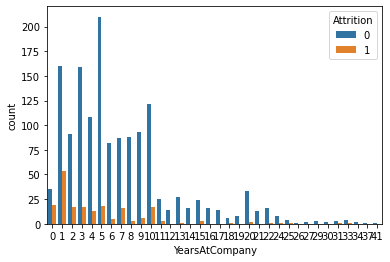

In [11]:
sns.countplot(x='YearsAtCompany', hue='Attrition', data=train)
plt.show()

Comments 
- here we can see that more employees leave the company when they have less number of years within a company. The number of years that we see most employees leavse is at 1,3 and 5 years. A few hypotheses we may have for this is possibly that employees who leave early in their employment (0-2 years) either arent not matched to their jobs (poor job profile matching), are only contrcated for this number of years or are unsatisfied. 

Attrition by total level of satisfaction (job satisafction +  environmental satisafaction and relationship satisfaction)

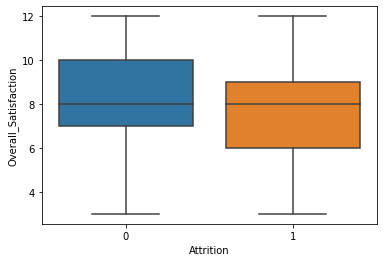

In [12]:
train['Overall_Satisfaction'] = train['JobSatisfaction'] + train['EnvironmentSatisfaction'] + train['RelationshipSatisfaction']
sns.boxplot(x='Attrition', y='Overall_Satisfaction', data=train)
plt.show()

Attrition by Monthly Income

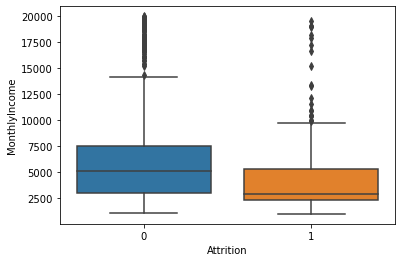

In [13]:
sns.boxplot(x='Attrition', y='MonthlyIncome', data=train)
plt.show()

Comments
- here we can see that employees who leave the company have a higher median income in compairson to those who do not leave the company. 


Attrition by Worklife Balance

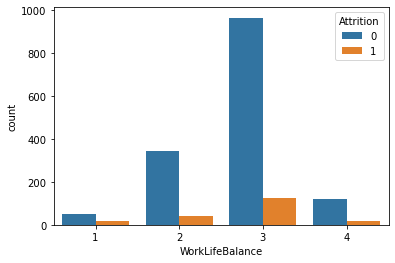

In [14]:
sns.countplot(x='WorkLifeBalance', hue='Attrition', data=train)
plt.show()

Comments
- we can see here that employyes do tend to leave more where they have a work life balance rating of 2 or 3. This is a factor to consider as we can see that work life balance may be quite a considerable factor in understanding employee attrition.

Attrition by Number of Years since last promotion 

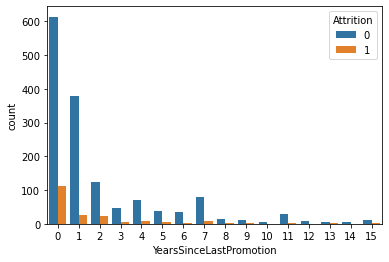

In [15]:
sns.countplot(x='YearsSinceLastPromotion', hue='Attrition', data=train)
plt.show()

Comments
- From this chart, we can see that in general that more employees leave the company when there are 0 years since last promotion than say 15 years. We do however have to consider that it is possible that employees do leave the company in their first 0-2 years of employment for other factors and so this may be just one of a few factors to consider when analysing the insights from this chart. 

Attrition by number of overtime hours worked

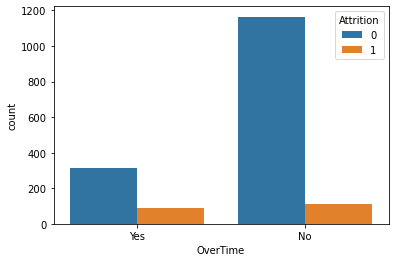

In [16]:
sns.countplot(x='OverTime', hue='Attrition', data=train)
plt.show()

Comments
- This graph shows that where there is no overtime work (no), more employees tend to leave than when there is no overtime. This could suggest that employees may feel limited to their growth as in may not feel the ability to "go the extra mile" in their work. Of course this is just a hypothesis and we will need to delve into this further to understand its relevance in understanding the attrition at the company.

Attrition by Stock Option Level

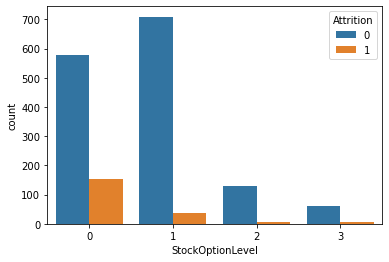

In [17]:
sns.countplot(x='StockOptionLevel', hue='Attrition', data=train)
plt.show()

Comments
- this chart shows that employees with a lower stock level are most likely to leave the company. This signals that stock level may be a good indicator of whether an employee will leave the company. This is something to consider further down.

Attrition by Performance Rating

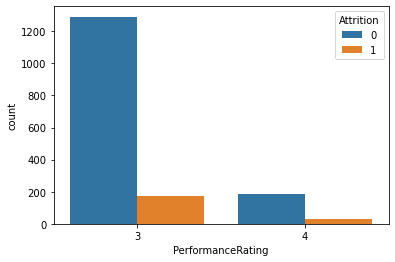

In [18]:
sns.countplot(x='PerformanceRating', hue='Attrition', data=train)
plt.show()

Comments
- Employees with a performance rating of 3 are more likely to leave the company compared to those with a rating of 4. This means that a poor performance rating could be a good indicator/driver for attrition.

# 5 Pre processing<a class="anchor" id="Pre-Proccesing"></a>

### Adjustment of Variables

In [19]:
train['Overall_Satisfaction'] =  (train['EnvironmentSatisfaction'] + train['JobSatisfaction'] + train['RelationshipSatisfaction'])

In [20]:
to_categorical = ['Education', 'EnvironmentSatisfaction', 'JobInvolvement', 'JobSatisfaction', 'PerformanceRating', 
                  'StockOptionLevel','RelationshipSatisfaction', 'WorkLifeBalance','JobLevel']
train[to_categorical] = train[to_categorical].astype('str')

We need to check if the values in the categorical variables have standard values.

In [21]:
 object_col = list(train.select_dtypes(include=['object']).columns)

In [22]:
for col in object_col:
    print(f'{col}: {train[col].unique()}')

BusinessTravel: ['Travel_Frequently' 'Travel_Rarely' 'Non-Travel']
Department: ['Research & Development' 'Sales' 'Human Resources']
Education: ['3' '4' '1' '2' '5' '15']
EducationField: ['Medical' 'Other' 'Marketing' 'Life Sciences' 'Technical Degree'
 'Human Resources']
EnvironmentSatisfaction: ['4' '1' '3' '2']
Gender: ['Male' 'Female']
JobInvolvement: ['3' '1' '2' '4']
JobLevel: ['1' '2' '5' '3' '4' '7']
JobRole: ['Laboratory Technician' 'Sales Representative' 'Sales Executive'
 'Healthcare Representative' 'Manager' 'Manufacturing Director'
 'Research Scientist' 'Human Resources' 'Research Director']
JobSatisfaction: ['4' '1' '2' '3']
MaritalStatus: ['Married' 'Divorced' 'Single']
Over18: ['Y']
OverTime: ['Yes' 'No']
PerformanceRating: ['3' '4']
RelationshipSatisfaction: ['2' '4' '3' '1']
StockOptionLevel: ['1' '2' '0' '3']
WorkLifeBalance: ['3' '1' '2' '4']


Using the description for the variables we were able to detect anomalies in the Education and JobLevel variables- Education has an outlier value of 15 and JobLevel of 7. We are going to check these values and decide how to change them.

In [23]:
train[train['Education'] == '15']

,id,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,Overall_Satisfaction
527,527,38,Travel_Rarely,548,Research & Development,1,15,Life Sciences,1,1,Female,72,3,1,Laboratory Technician,4,Divorced,2644,6217,7,Y,No,13,3,1,80,1,7,2,3,5,2,1,4,0,6


For this specific case we have decided to update the value to 5 since it seems to follow charectistics of doctorate level professional.We say this becauses this employee has a Job Role of bieng a Laboratory Technician and we have seen in previous analysis that the employees with this job role have a doctorate level education. FUrther, we have fouhnd this consistency with employees who come from the Research and Development department.

In [24]:
train.loc[527, 'Education'] = '5'

In [25]:
train[train['JobLevel'] == '7']

,id,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,Overall_Satisfaction
1535,1535,30,Travel_Rarely,583,Research & Development,6,3,Life Sciences,1,4,Female,100,3,7,Manufacturing Director,3,Single,5326,22490,3,Y,No,13,3,4,80,0,12,1,2,8,7,1,5,0,11


In [26]:
train.loc[1535, 'JobLevel'] = '5'

We adjust the JobLevel education wrong assing vairable from 7 to 5 and i so, we decided to clamp this outlier as 5 was the highest job level.

Through out the drescriptive analysis also, allowed us to find some variables that contain a unique value across all the employes in the whole dataset:
- *Over18*
- *EmployeeCount*
- *StandardHours*
- *ID*

These variables are going to be dropped of the dataset as they don't provide any relevant information.

In [27]:
drop = ['Over18', 'EmployeeCount', 'StandardHours', 'id' ]
train = train.drop(labels =  drop, axis =1)

### Missing Values

We are going to check for any missing values in the dataset. 

In [28]:
train.isna().sum()

Age                         0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSinceLastPromotion     0
YearsWithCurrManager        0
Attrition                   0
Overall_Satisfaction        0
dtype: int64

We don't have any missing values on our data set.

### Duplicate Values

In [29]:
train.duplicated().sum()

0

In the data set we **don't** have duplicate values.

### Correlation between Variables

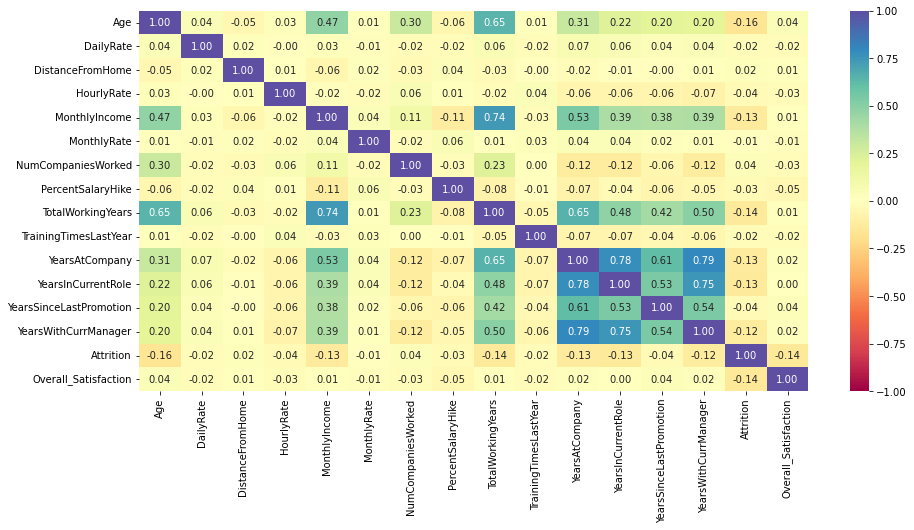

In [30]:
cols_list = train.select_dtypes(include=np.number).columns.tolist()

plt.figure(figsize=(15, 7))
sns.heatmap(
    train[cols_list].corr(), annot=True, vmin=-1, vmax=1, fmt=".2f", cmap="Spectral"
)
plt.show()

Since tthe DailyRate and the HourlyRate by definition of the variables are related to the MonthlyRate these two variable are going to be dropped form the analysis. 

In [31]:
drop = ['DailyRate','HourlyRate']

train = train.drop(labels =  drop, axis =1)

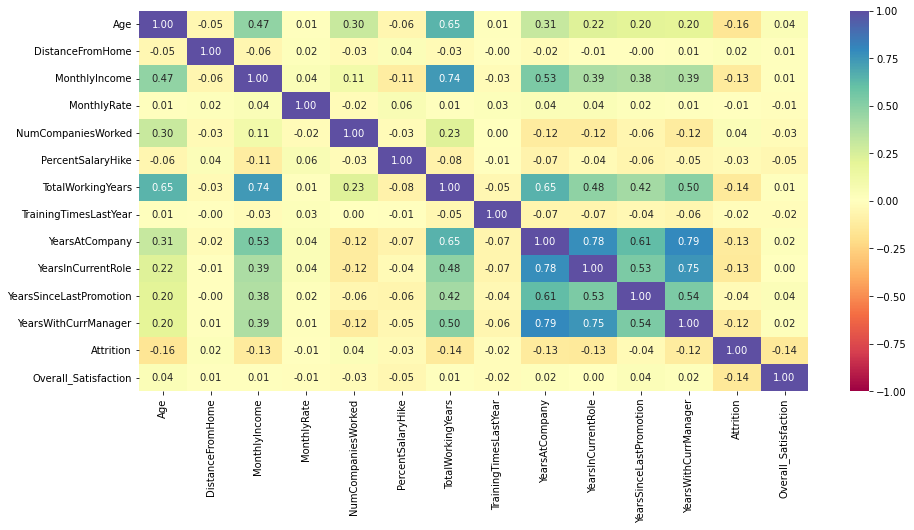

In [32]:
cols_list = train.select_dtypes(include=np.number).columns.tolist()

plt.figure(figsize=(15, 7))
sns.heatmap(
    train[cols_list].corr(), annot=True, vmin=-1, vmax=1, fmt=".2f", cmap="Spectral"
)
plt.show()

### Transformation of Categorical Values

We are making a transformations on the categorical values in order to obtain a level of information at the moment we realize the encoding of the variables. Also, we ran into some torubles while encoding the variables as the values were repeated and created columns with similar names.

In [33]:
train['BusinessTravel'] = train['BusinessTravel'].map({'Travel_Frequently': 'BussTrvl_Frequently', 
                                             'Travel_Rarely': 'BussTrvl_Rately', 
                                             'Non-Travel': 'BussTrvl_None' 
                                                      })

train['Department'] = train['Department'].map({'Research & Development': 'Dept_R&D', 
                                             'Sales': 'Dept_Sales', 
                                             'Human Resources': 'Dept_HHRR'
                                              }) 

train['EducationField'] = train['EducationField'].map({'Medical': 'EduFld_Med', 
                                                       'Other': 'EduFld_Othr',
                                                       'Marketing': 'EduFld_Mark',
                                                       'Life Sciences': 'EduFld_LSC', 
                                                       'Technical Degree': 'EduFld_TechDeg',
                                                       'Human Resources': 'EduFld_HHRR'
                                                      }) 

train['JobRole'] = train['JobRole'].map({'Laboratory Technician': 'JbRo_LabTech', 
                                         'Sales Representative': 'JbRo_SalesRep',
                                         'Sales Executive': 'JbRo_SalesExc',
                                         'Healthcare Representative': 'JbRo_HCRep',
                                         'Manager': 'JbRo_Mang',
                                         'Manufacturing Director': 'JbRo_ManDir',
                                         'Research Scientist': 'JbRo_RSc',
                                         'Human Resources': 'JbRo_HHRR',
                                         'Research Director': 'JbRo_ResDir',}) 

train['MaritalStatus'] = train['MaritalStatus'].map({'Married': 'MartStat_Marr', 
                                             'Divorced': 'MartStat_Div', 
                                             'Single': 'MartStat_Sing'
                                                    }) 

train['OverTime'] = train['OverTime'].map({'Yes': 'OverT_Yes',
                                           'No': 'OverT_No'
                                          }) 


train['Education'] = train['Education'].map({'3': 'Edu_Bachellor', 
                                             '4': 'Edu_Master', 
                                             '1': 'Edu_Below_Coll', 
                                             '2': 'Edu_College', 
                                             '5': 'Edu_Doctor'})

train['EnvironmentSatisfaction'] = train['EnvironmentSatisfaction'].map({'3': 'EnvSat_High',
                                                       '1': 'EnvSat_Low', 
                                                       '2': 'EnvSat_Medium',
                                                       '4': 'EnvSat_Very_High'})

train['JobInvolvement'] = train['JobInvolvement'].map({'3': 'JobInv_High',
                                                       '1': 'JobInv_Low', 
                                                       '2': 'JobInv_Medium',
                                                       '4': 'JobInv_Very_High'})
train['JobSatisfaction'] = train['JobSatisfaction'].map({'3': 'JobSat_High',
                                                       '1': 'JobSat_Low', 
                                                       '2': 'JobSat_Medium',
                                                       '4': 'JobSat_Very_High'})

train['PerformanceRating'] = train['PerformanceRating'].map({'3': 'PerfRat_Excellent',
                                                       '1': 'PerfRat_Low', 
                                                       '2': 'PerfRat_Good',
                                                       '4': 'PerfRat_Outstanding',})
train['RelationshipSatisfaction'] = train['RelationshipSatisfaction'].map({'3': 'RelSat_High',
                                                       '1': 'RelSat_Low', 
                                                       '2': 'RelSat_Medium',
                                                       '4': 'RelSat_Very_High'})

train['WorkLifeBalance'] = train['WorkLifeBalance'].map({'3': 'WLB_Better',
                                                       '1': 'WLB_Bad', 
                                                       '2': 'WLB_Good',
                                                       '4': 'WLB_Best'})

train['StockOptionLevel'] = train['StockOptionLevel'].map({'0': 'SOL_0',
                                                       '1': 'SOL_1', 
                                                       '2': 'SOL_2',
                                                       '3': 'SOL_3'})

train['JobLevel'] = train['JobLevel'].map({'1': 'JL_1',
                                                       '2': 'JL_2', 
                                                       '3': 'JL_3',
                                                       '4': 'JL_4',
                                                       '5': 'JL_5'})

In [34]:
train.head(10)

,Age,BusinessTravel,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,Overall_Satisfaction
0,36,BussTrvl_Frequently,Dept_R&D,24,Edu_Bachellor,EduFld_Med,EnvSat_Very_High,Male,JobInv_High,JL_1,JbRo_LabTech,JobSat_Very_High,MartStat_Marr,2596,5099,1,OverT_Yes,13,PerfRat_Excellent,RelSat_Medium,SOL_1,10,2,WLB_Better,10,0,7,8,0,10
1,35,BussTrvl_Rately,Dept_Sales,8,Edu_Bachellor,EduFld_Othr,EnvSat_Low,Male,JobInv_High,JL_1,JbRo_SalesRep,JobSat_Low,MartStat_Marr,2899,10778,1,OverT_No,17,PerfRat_Excellent,RelSat_Very_High,SOL_1,4,3,WLB_Better,4,2,0,3,0,6
2,32,BussTrvl_Rately,Dept_Sales,26,Edu_Bachellor,EduFld_Mark,EnvSat_High,Male,JobInv_High,JL_2,JbRo_SalesExc,JobSat_Very_High,MartStat_Div,4627,16495,0,OverT_No,17,PerfRat_Excellent,RelSat_Very_High,SOL_2,4,3,WLB_Better,3,2,1,2,0,11
3,38,BussTrvl_Rately,Dept_R&D,2,Edu_Bachellor,EduFld_Med,EnvSat_High,Female,JobInv_High,JL_2,JbRo_HCRep,JobSat_Low,MartStat_Marr,5347,13384,3,OverT_No,14,PerfRat_Excellent,RelSat_High,SOL_0,15,1,WLB_Bad,6,0,0,2,0,7
4,50,BussTrvl_Rately,Dept_R&D,5,Edu_Master,EduFld_Med,EnvSat_Medium,Female,JobInv_High,JL_5,JbRo_Mang,JobSat_Low,MartStat_Sing,19033,19805,1,OverT_Yes,13,PerfRat_Excellent,RelSat_High,SOL_0,31,0,WLB_Better,31,14,4,10,1,6
5,27,BussTrvl_Rately,Dept_R&D,2,Edu_Bachellor,EduFld_Othr,EnvSat_High,Female,JobInv_High,JL_2,JbRo_ManDir,JobSat_Medium,MartStat_Sing,4197,7103,5,OverT_No,11,PerfRat_Excellent,RelSat_Very_High,SOL_0,6,0,WLB_Better,1,0,1,0,0,9
6,34,BussTrvl_Rately,Dept_R&D,10,Edu_Master,EduFld_Med,EnvSat_Medium,Male,JobInv_High,JL_1,JbRo_LabTech,JobSat_Low,MartStat_Sing,1281,16900,1,OverT_No,13,PerfRat_Excellent,RelSat_Low,SOL_0,1,2,WLB_Better,1,0,0,0,0,4
7,40,BussTrvl_Rately,Dept_R&D,2,Edu_Bachellor,EduFld_LSC,EnvSat_Very_High,Male,JobInv_High,JL_1,JbRo_LabTech,JobSat_Very_High,MartStat_Div,3067,12916,2,OverT_No,12,PerfRat_Excellent,RelSat_Very_High,SOL_1,6,3,WLB_Good,3,2,1,2,0,12
8,51,BussTrvl_Frequently,Dept_Sales,6,Edu_Bachellor,EduFld_LSC,EnvSat_Very_High,Male,JobInv_Low,JL_2,JbRo_SalesExc,JobSat_Very_High,MartStat_Marr,6439,21221,8,OverT_Yes,13,PerfRat_Excellent,RelSat_Low,SOL_1,18,3,WLB_Better,16,14,4,9,0,9
9,25,BussTrvl_Rately,Dept_R&D,9,Edu_Below_Coll,EduFld_Med,EnvSat_High,Female,JobInv_High,JL_1,JbRo_LabTech,JobSat_High,MartStat_Marr,2741,7950,1,OverT_No,15,PerfRat_Excellent,RelSat_High,SOL_1,9,2,WLB_Good,9,7,7,8,0,9


# 6 Feauture Engineering<a class="anchor" id="Feauture-Engineering"></a>

In [35]:
zeros_count = (train['TotalWorkingYears'] == 0).sum()
if zeros_count > 0:
    print("Column 'TotalWorkingYears' has", zeros_count, "zeros")
else:
    print("Column 'TotalWorkingYears' does not have zeros")

Column 'TotalWorkingYears' has 13 zeros


In [36]:
#showing average amount of time employee spent per company. TotalWorkingYears/NumCompaniesWorked
train['YrsPerCompany'] = (train['TotalWorkingYears'] - train['YearsAtCompany']) / train['NumCompaniesWorked']
train.loc[(train['TotalWorkingYears'] == 0) | (train['NumCompaniesWorked'] == 0), 'YrsPerCompany'] = train['YearsAtCompany']

train['YrsPerCompany']

0       0.0
1       0.0
2       3.0
3       3.0
4       0.0
       ... 
1672    0.0
1673    1.5
1674    0.0
1675    0.0
1676    8.0
Name: YrsPerCompany, Length: 1677, dtype: float64

In [37]:
train.head()

,Age,BusinessTravel,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,Overall_Satisfaction,YrsPerCompany
0,36,BussTrvl_Frequently,Dept_R&D,24,Edu_Bachellor,EduFld_Med,EnvSat_Very_High,Male,JobInv_High,JL_1,JbRo_LabTech,JobSat_Very_High,MartStat_Marr,2596,5099,1,OverT_Yes,13,PerfRat_Excellent,RelSat_Medium,SOL_1,10,2,WLB_Better,10,0,7,8,0,10,0.0
1,35,BussTrvl_Rately,Dept_Sales,8,Edu_Bachellor,EduFld_Othr,EnvSat_Low,Male,JobInv_High,JL_1,JbRo_SalesRep,JobSat_Low,MartStat_Marr,2899,10778,1,OverT_No,17,PerfRat_Excellent,RelSat_Very_High,SOL_1,4,3,WLB_Better,4,2,0,3,0,6,0.0
2,32,BussTrvl_Rately,Dept_Sales,26,Edu_Bachellor,EduFld_Mark,EnvSat_High,Male,JobInv_High,JL_2,JbRo_SalesExc,JobSat_Very_High,MartStat_Div,4627,16495,0,OverT_No,17,PerfRat_Excellent,RelSat_Very_High,SOL_2,4,3,WLB_Better,3,2,1,2,0,11,3.0
3,38,BussTrvl_Rately,Dept_R&D,2,Edu_Bachellor,EduFld_Med,EnvSat_High,Female,JobInv_High,JL_2,JbRo_HCRep,JobSat_Low,MartStat_Marr,5347,13384,3,OverT_No,14,PerfRat_Excellent,RelSat_High,SOL_0,15,1,WLB_Bad,6,0,0,2,0,7,3.0
4,50,BussTrvl_Rately,Dept_R&D,5,Edu_Master,EduFld_Med,EnvSat_Medium,Female,JobInv_High,JL_5,JbRo_Mang,JobSat_Low,MartStat_Sing,19033,19805,1,OverT_Yes,13,PerfRat_Excellent,RelSat_High,SOL_0,31,0,WLB_Better,31,14,4,10,1,6,0.0


We set up our values for the explained and explanatory variables. 

#### One Hot Encoding

In [38]:
X_train = train.drop('Attrition', axis = 1)
y_train = train['Attrition']

In [39]:
ohe = OneHotEncoder(sparse=False)
cat_data = train.select_dtypes("O")
cat_data_columns = train.select_dtypes("O").columns
cat_data_ohe = ohe.fit_transform(cat_data)
np.concatenate(ohe.categories_, axis=0 )

cat_data_ohe = pd.DataFrame(cat_data_ohe)
cat_data_ohe.columns = np.concatenate(ohe.categories_, axis=0 )

new_train = pd.concat([train, cat_data_ohe], axis=1)

In [40]:
new_train

,Age,BusinessTravel,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,Overall_Satisfaction,YrsPerCompany,BussTrvl_Frequently,BussTrvl_None,BussTrvl_Rately,Dept_HHRR,Dept_R&D,Dept_Sales,Edu_Bachellor,Edu_Below_Coll,Edu_College,Edu_Doctor,Edu_Master,EduFld_HHRR,EduFld_LSC,EduFld_Mark,EduFld_Med,EduFld_Othr,EduFld_TechDeg,EnvSat_High,EnvSat_Low,EnvSat_Medium,EnvSat_Very_High,Female,Male,JobInv_High,JobInv_Low,JobInv_Medium,JobInv_Very_High,JL_1,JL_2,JL_3,JL_4,JL_5,JbRo_HCRep,JbRo_HHRR,JbRo_LabTech,JbRo_ManDir,JbRo_Mang,JbRo_RSc,JbRo_ResDir,JbRo_SalesExc,JbRo_SalesRep,JobSat_High,JobSat_Low,JobSat_Medium,JobSat_Very_High,MartStat_Div,MartStat_Marr,MartStat_Sing,OverT_No,OverT_Yes,PerfRat_Excellent,PerfRat_Outstanding,RelSat_High,RelSat_Low,RelSat_Medium,RelSat_Very_High,SOL_0,SOL_1,SOL_2,SOL_3,WLB_Bad,WLB_Best,WLB_Better,WLB_Good
0,36,BussTrvl_Frequently,Dept_R&D,24,Edu_Bachellor,EduFld_Med,EnvSat_Very_High,Male,JobInv_High,JL_1,JbRo_LabTech,JobSat_Very_High,MartStat_Marr,2596,5099,1,OverT_Yes,13,PerfRat_Excellent,RelSat_Medium,SOL_1,10,2,WLB_Better,10,0,7,8,0,10,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
1,35,BussTrvl_Rately,Dept_Sales,8,Edu_Bachellor,EduFld_Othr,EnvSat_Low,Male,JobInv_High,JL_1,JbRo_SalesRep,JobSat_Low,MartStat_Marr,2899,10778,1,OverT_No,17,PerfRat_Excellent,RelSat_Very_High,SOL_1,4,3,WLB_Better,4,2,0,3,0,6,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
2,32,BussTrvl_Rately,Dept_Sales,26,Edu_Bachellor,EduFld_Mark,EnvSat_High,Male,JobInv_High,JL_2,JbRo_SalesExc,JobSat_Very_High,MartStat_Div,4627,16495,0,OverT_No,17,PerfRat_Excellent,RelSat_Very_High,SOL_2,4,3,WLB_Better,3,2,1,2,0,11,3.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
3,38,BussTrvl_Rately,Dept_R&D,2,Edu_Bachellor,EduFld_Med,EnvSat_High,Female,JobInv_High,JL_2,JbRo_HCRep,JobSat_Low,MartStat_Marr,5347,13384,3,OverT_No,14,PerfRat_Excellent,RelSat_High,SOL_0,15,1,WLB_Bad,6,0,0,2,0,7,3.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,50,BussTrvl_Rately,Dept_R&D,5,Edu_Master,EduFld_Med,EnvSat_Medium,Female,JobInv_High,JL_5,JbRo_Mang,JobSat_Low,MartStat_Sing,19033,19805,1,OverT_Yes,13,PerfRat_Excellent,RelSat_High,SOL_0,31,0,WLB_Better,31,14,4,10,1,6,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

In [41]:
new_train = new_train.drop(cat_data_columns, axis = 1)

In [42]:
new_train

,Age,DistanceFromHome,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,Overall_Satisfaction,YrsPerCompany,BussTrvl_Frequently,BussTrvl_None,BussTrvl_Rately,Dept_HHRR,Dept_R&D,Dept_Sales,Edu_Bachellor,Edu_Below_Coll,Edu_College,Edu_Doctor,Edu_Master,EduFld_HHRR,EduFld_LSC,EduFld_Mark,EduFld_Med,EduFld_Othr,EduFld_TechDeg,EnvSat_High,EnvSat_Low,EnvSat_Medium,EnvSat_Very_High,Female,Male,JobInv_High,JobInv_Low,JobInv_Medium,JobInv_Very_High,JL_1,JL_2,JL_3,JL_4,JL_5,JbRo_HCRep,JbRo_HHRR,JbRo_LabTech,JbRo_ManDir,JbRo_Mang,JbRo_RSc,JbRo_ResDir,JbRo_SalesExc,JbRo_SalesRep,JobSat_High,JobSat_Low,JobSat_Medium,JobSat_Very_High,MartStat_Div,MartStat_Marr,MartStat_Sing,OverT_No,OverT_Yes,PerfRat_Excellent,PerfRat_Outstanding,RelSat_High,RelSat_Low,RelSat_Medium,RelSat_Very_High,SOL_0,SOL_1,SOL_2,SOL_3,WLB_Bad,WLB_Best,WLB_Better,WLB_Good
0,36,24,2596,5099,1,13,10,2,10,0,7,8,0,10,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
1,35,8,2899,10778,1,17,4,3,4,2,0,3,0,6,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
2,32,26,4627,16495,0,17,4,3,3,2,1,2,0,11,3.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
3,38,2,5347,13384,3,14,15,1,6,0,0,2,0,7,3.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,50,5,19033,19805,1,13,31,0,31,14,4,10,1,6,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1672,30,1,8722,14255,1,19,10,2,10,0,0,8,0,9,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1673,32,2,3544,15972,4,19,10,3,4,2,1,3,0,7,1.5,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
1674,29,24,2804,15322,1,11,1,2,1,0,0,0,1,6,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1675,36,9,5406,4051,1,21,10,3,10,3,0,8,0,8,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0

#### Oversampling

In [43]:
#pip install -U imbalanced-learn

In [44]:
Oversample=SMOTE()

In [45]:
X=new_train.drop(['Attrition'], axis = 1) #'cluster_ids'
y=new_train['Attrition']

X_over,Y_over=Oversample.fit_resample(X,y)

new_x=pd.DataFrame(X_over)
new_y=pd.DataFrame(Y_over)

new_train = pd.concat([new_x, new_y], axis=1)

## Standard SCALING

In [46]:
Num_Var=new_train[['Age','DistanceFromHome','MonthlyIncome','MonthlyRate','NumCompaniesWorked','PercentSalaryHike','TotalWorkingYears','TrainingTimesLastYear','YearsInCurrentRole','YearsSinceLastPromotion','YearsWithCurrManager']]

scl = StandardScaler()
scl.fit(Num_Var)
train_sc = scl.transform(Num_Var)

# the result is returned as a numpy array, so let's convert it again to a Padnas Df
train_sc = pd.DataFrame(train_sc, columns=Num_Var.columns)

In [47]:
new_train = new_train.drop(columns=['Age','DistanceFromHome','MonthlyIncome','MonthlyRate','NumCompaniesWorked','PercentSalaryHike','TotalWorkingYears','TrainingTimesLastYear','YearsInCurrentRole','YearsSinceLastPromotion','YearsWithCurrManager'], axis = 1)

In [48]:
new_train = pd.concat([new_train, train_sc], axis=1)

In [49]:
new_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2954 entries, 0 to 2953
Data columns (total 79 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   YearsAtCompany           2954 non-null   int64  
 1   Overall_Satisfaction     2954 non-null   int64  
 2   YrsPerCompany            2954 non-null   float64
 3   BussTrvl_Frequently      2954 non-null   float64
 4   BussTrvl_None            2954 non-null   float64
 5   BussTrvl_Rately          2954 non-null   float64
 6   Dept_HHRR                2954 non-null   float64
 7   Dept_R&D                 2954 non-null   float64
 8   Dept_Sales               2954 non-null   float64
 9   Edu_Bachellor            2954 non-null   float64
 10  Edu_Below_Coll           2954 non-null   float64
 11  Edu_College              2954 non-null   float64
 12  Edu_Doctor               2954 non-null   float64
 13  Edu_Master               2954 non-null   float64
 14  EduFld_HHRR             

# 7 Modeling of the Data<a class="anchor" id="Modeling-of-the-Data"></a> 

In [50]:
y = new_train['Attrition']
X = new_train.drop(columns='Attrition', axis = 1)

### Train & Test Split

We are going to create our X_train, X_test, y_train, y_test so all the models use the same information.

In [51]:
seed = 1337
test_size = 0.25

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=seed)

#### XGBClassifier - First Model

In [52]:
model_XGBC = XGBClassifier(objective='binary:logistic', seed = 1337)
model_XGBC.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [53]:
# make predictions for test data
y_pred = model_XGBC.predict(X_test)
predictions = [round(value) for value in y_pred]

# evaluate predictions
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

Accuracy: 94.05%


In [54]:
# make predictions for test data
y_pred = model_XGBC.predict(X_test)
y_proba = model_XGBC.predict_proba(X_test)
predictions = [round(value) for value in y_pred]

# evaluate predictions
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

Accuracy: 94.05%


In [55]:
#ROC Score
roc_auc = roc_auc_score(y_test, y_proba[:,1])
print('ROC AUC score:', roc_auc)

ROC AUC score: 0.9793626373626373


Random Grid search through XGBClassifier

In [56]:
parameters = {
        'learning_rate': [0.01,0.1,0.5,0.75,1,2],
        'n_estimators': [1,5,10,15],
        'min_child_weight': [1,2,3,4,5,6,7,8,9,10],
        'gamma': [0,25, 0.5, 0.75, 1, 1.25,1.5],
        'subsample': [0.6, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.8, 1.0],
        'max_depth': [3, 4, 5, 6]
        }
clf_XGBC = RandomizedSearchCV( model_XGBC, 
                              parameters, 
                              cv=5,
                              scoring= 'roc_auc', 
                              n_iter=2000, 
                              n_jobs= -1,
                              random_state=  1337
)

In [57]:
clf_XGBC.fit(X_train, y_train)

RandomizedSearchCV(cv=5,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           callbacks=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None,
                                           early_stopping_rounds=None,
                                           enable_categorical=False,
                                           eval_metric=None, feature_types=None,
                                           gamma=None, gpu_id=None,
                                           grow_policy=None,
                                           importance_type=None,
                                           interaction_constraints=None,
                                           learning_rate...
                                           num_parallel_tree=None,
                            

In [58]:
best_est = clf_XGBC.best_estimator_
probs = best_est.predict_proba(X_test)[:,1]
results_clf_xgb = best_est.predict(X_test)

In [59]:
roc_auc = roc_auc_score(y_test, probs)
print('ROC AUC score:', roc_auc)

ROC AUC score: 0.9813626373626374


In [60]:
cm = confusion_matrix(y_test, results_clf_xgb)
acc = accuracy_score(y_test, results_clf_xgb)
print("Confusion Matrix: \n", cm)
print("Accuracy: ", acc)

Confusion Matrix: 
 [[363  12]
 [ 35 329]]
Accuracy:  0.9364005412719891


In [61]:
class_df_xg = pd.DataFrame(classification_report(y_test, best_est.predict(X_test), output_dict=True)).T
class_df_xg['Model'] = 'XGBoost'
class_df_xg

,precision,recall,f1-score,support,Model
0,0.912060,0.968000,0.939198,375.000000,XGBoost
1,0.964809,0.903846,0.933333,364.000000,XGBoost
accuracy,0.936401,0.936401,0.936401,0.936401,XGBoost
macro avg,0.938435,0.935923,0.936266,739.000000,XGBoost
weighted avg,0.938042,0.936401,0.936309,739.000000,XGBoost


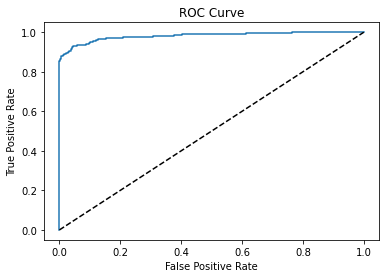

In [62]:
#Plot an Roc Curve
fpr, tpr, thresholds = roc_curve(y_test, probs)
plt.plot(fpr, tpr, label=f'ROC = {roc_auc_score(y_test, probs):.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

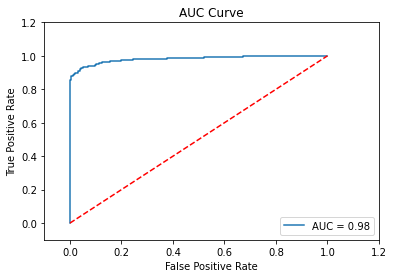

In [63]:
#Plot an AUC Curve
auc(fpr, tpr)
#plot it
plt.plot(fpr, tpr, label='AUC = %0.2f'% auc(fpr, tpr))
plt.legend(loc='lower right')
plt.plot([0,1],[0,1],'r--')
plt.xlim([-0.1,1.2])
plt.ylim([-0.1,1.2])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.title('AUC Curve')
plt.show()

#### Logistic Regression - Second Model

In [64]:
lr = LogisticRegression(penalty='l1', solver='liblinear', C=0.2)

In [65]:
#fit the model
lr.fit(X_train, y_train)

LogisticRegression(C=0.2, penalty='l1', solver='liblinear')

In [66]:
#using predict_proba on x_test to determine prediction of y_test, compared with the actual value in the target set 
probs = lr.predict_proba(X_test)[:,1] #one is default

predictions = pd.DataFrame({'Attrition':y_test, 'pred':probs})
predictions.head()

,Attrition,pred
282,1,0.179530
958,0,0.598361
2195,1,0.707416
2025,1,0.637293
2267,1,0.784142


In [67]:
roc_auc = roc_auc_score(y_test, probs)
print('ROC AUC score:', roc_auc)

ROC AUC score: 0.9151575091575093


In [68]:
cm = confusion_matrix(y_test, y_pred.round())
acc = accuracy_score(y_test, y_pred.round())
print("Confusion Matrix: \n", cm)
print("Accuracy: ", acc)

Confusion Matrix: 
 [[366   9]
 [ 35 329]]
Accuracy:  0.9404600811907984


In [69]:
from sklearn.model_selection import GridSearchCV

parameters = {'C': [0.01, 0.1, 1, 10], 'penalty': ['l1', 'l2'], 'solver': ['liblinear']}
clf_lr = GridSearchCV(lr, parameters, cv=5, scoring= 'roc_auc')

In [70]:
clf_lr.fit(X_train, y_train)

C:\Users\Pulin\anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\Pulin\anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\Pulin\anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\Pulin\anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\Pulin\anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\Pulin\anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.


GridSearchCV(cv=5,
             estimator=LogisticRegression(C=0.2, penalty='l1',
                                          solver='liblinear'),
             param_grid={'C': [0.01, 0.1, 1, 10], 'penalty': ['l1', 'l2'],
                         'solver': ['liblinear']},
             scoring='roc_auc')

In [71]:
best_est = clf_lr.best_estimator_
probs = best_est.predict_proba(X_test)[:,1]

In [72]:
results_clf_lr = best_est.predict(X_test)

In [73]:
roc_auc = roc_auc_score(y_test, probs)
print('ROC AUC score:', roc_auc)

ROC AUC score: 0.9652527472527472


In [74]:
cm = confusion_matrix(y_test, results_clf_lr)
acc = accuracy_score(y_test, results_clf_lr)
print("Confusion Matrix: \n", cm)
print("Accuracy: ", acc)

Confusion Matrix: 
 [[351  24]
 [ 53 311]]
Accuracy:  0.8958051420838972


In [75]:
class_df_lr = pd.DataFrame(classification_report(y_test, best_est.predict(X_test), output_dict=True)).T
class_df_lr['Model'] = 'Logistic Regression'
class_df_lr
class_df = pd.concat([class_df_lr, class_df_xg], axis=0)

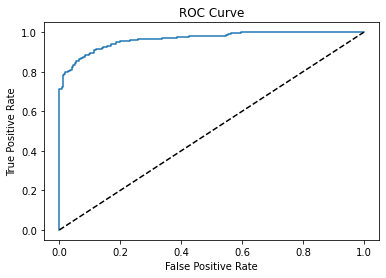

In [76]:
#Plot an Roc Curve
fpr, tpr, thresholds = roc_curve(y_test, probs)
plt.plot(fpr, tpr, label=f'ROC = {roc_auc_score(y_test, probs):.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

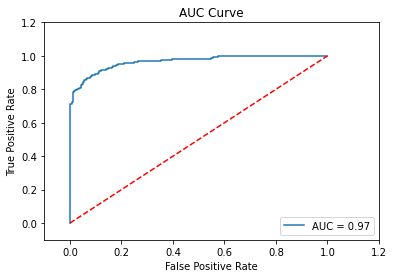

In [77]:
#Plot an AUC Curve
auc(fpr, tpr)
#plot it
plt.plot(fpr, tpr, label='AUC = %0.2f'% auc(fpr, tpr))
plt.legend(loc='lower right')
plt.plot([0,1],[0,1],'r--')
plt.xlim([-0.1,1.2])
plt.ylim([-0.1,1.2])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.title('AUC Curve')
plt.show()

#### Random Forest - Third Model

In [78]:
rf = RandomForestRegressor(random_state=1337, max_features = 'sqrt')
att_rf = rf.fit(X_train, y_train)  
y_pred_1 = att_rf.predict(X_test)
#y_pred = np.round(y_pred_1)
print("MSE = ", mean_squared_error(y_test, y_pred))

MSE =  0.05953991880920163


In [79]:
att_feat = rf.feature_importances_
att_cols = X_train.columns
att_imp = pd.DataFrame({"Feature": att_cols, "Importance": att_feat}).sort_values('Importance', ascending=False)
att_imp.head(10)

,Feature,Importance
59,SOL_0,0.074760
52,OverT_Yes,0.064951
50,MartStat_Sing,0.064215
51,OverT_No,0.045457
60,SOL_1,0.044843
69,MonthlyIncome,0.030591
1,Overall_Satisfaction,0.027371
49,MartStat_Marr,0.025054
30,JL_1,0.024692
47,JobSat_Very_High,0.022603


In [80]:
cm = confusion_matrix(y_test, y_pred.round())
acc = accuracy_score(y_test, y_pred.round())
print("Confusion Matrix: \n", cm)
print("Accuracy: ", acc)

Confusion Matrix: 
 [[366   9]
 [ 35 329]]
Accuracy:  0.9404600811907984


In [135]:
#Creation of the paramters for the Random Grid Search
param_grid = {
    'max_depth': range(1, 10), 
    'min_samples_leaf': range(1, 10),
    'max_features': ['sqrt', 'log2'],
    'n_estimators': [10, 50, 100, 200, 500]
}

clf_rf_pruned = RandomizedSearchCV(
    rf,
    param_grid,
    cv=10,
    scoring='roc_auc',
    verbose=1, n_jobs=-1,
    n_iter= 810,
    random_state = 1337
)

clf_rf_pruned.fit(X_train, y_train)

Fitting 10 folds for each of 810 candidates, totalling 8100 fits


RandomizedSearchCV(cv=10,
                   estimator=RandomForestRegressor(max_features='sqrt',
                                                   random_state=1337),
                   n_iter=810, n_jobs=-1,
                   param_distributions={'max_depth': range(1, 10),
                                        'max_features': ['sqrt', 'log2'],
                                        'min_samples_leaf': range(1, 10),
                                        'n_estimators': [10, 50, 100, 200,
                                                         500]},
                   random_state=1337, scoring='roc_auc', verbose=1)

In [136]:
att_feat = clf_rf_pruned.best_estimator_.feature_importances_
att_names = X_train.columns
att_feature_imp = pd.DataFrame({"Features": att_names, 'Importance': att_feat}).sort_values('Importance', ascending = False)
att_feature_imp.head(10)

,Features,Importance
59,SOL_0,0.063961
60,SOL_1,0.062246
50,MartStat_Sing,0.061922
52,OverT_Yes,0.061677
51,OverT_No,0.054039
49,MartStat_Marr,0.030555
47,JobSat_Very_High,0.028080
23,EnvSat_Very_High,0.027483
69,MonthlyIncome,0.026021
30,JL_1,0.024442


In [137]:
fig = px.bar(att_feature_imp, x='Features', y='Importance')
fig.show()

In [138]:
X_val_pred = clf_rf_pruned.predict(X_test)

In [139]:
X_val_pred_pd = pd.DataFrame(X_val_pred)

In [140]:
cm = confusion_matrix(y_test, X_val_pred.round())
acc = accuracy_score(y_test, X_val_pred.round())
print("Confusion Matrix: \n", cm)
print("Accuracy: ", acc)

Confusion Matrix: 
 [[363  12]
 [ 32 332]]
Accuracy:  0.9404600811907984


In [141]:
print(f"MSE = {mean_squared_error(y_test, X_val_pred)}")

MSE = 0.058145862030048276


In [142]:
roc_auc_score(y_test, X_val_pred)

0.9847472527472528

In [143]:
class_df_rf = pd.DataFrame(classification_report(y_test, X_val_pred.round(), output_dict=True)).T
class_df_rf['Model'] = 'Random Forest'
class_df = pd.concat([class_df_rf, class_df_lr, class_df_xg], axis=0)

In [144]:
class_df

,precision,recall,f1-score,support,Model
0,0.918987,0.968000,0.942857,375.000000,Random Forest
1,0.965116,0.912088,0.937853,364.000000,Random Forest
accuracy,0.940460,0.940460,0.940460,0.940460,Random Forest
macro avg,0.942052,0.940044,0.940355,739.000000,Random Forest
weighted avg,0.941708,0.940460,0.940392,739.000000,Random Forest
0,0.868812,0.936000,0.901155,375.000000,Logistic Regression
1,0.928358,0.854396,0.889843,364.000000,Logistic Regression
accuracy,0.895805,0.895805,0.895805,0.895805,Logistic Regression
macro avg,0.898585,0.895198,0.895499,739.000000,Logistic Regression
weighted avg,0.898142,0.895805,0.895583,739.000000,Logistic Regression


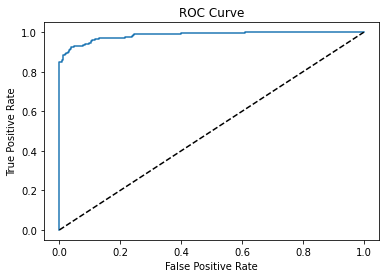

In [91]:
#Plot an Roc Curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(y_test, X_val_pred)
plt.plot(fpr, tpr, label=f'ROC = {roc_auc_score(y_test, X_val_pred):.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

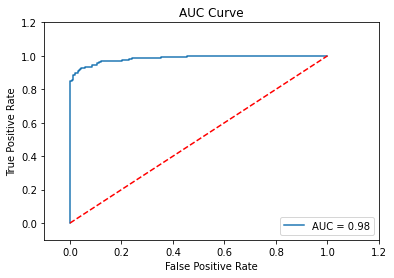

In [92]:
#Plot an AUC Curve
from sklearn.metrics import auc
auc(fpr, tpr)
#plot it
plt.plot(fpr, tpr, label='AUC = %0.2f'% auc(fpr, tpr))
plt.legend(loc='lower right')
plt.plot([0,1],[0,1],'r--')
plt.xlim([-0.1,1.2])
plt.ylim([-0.1,1.2])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.title('AUC Curve')
plt.show()

In [93]:
# Find the optimal threshold
fpr, tpr, thresholds = roc_curve(y_test, X_val_pred)
optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]

optimal_threshold

0.4635554452591596

#### SVM - Fourth Model

In [94]:
model_SVM = SVC(probability=True)

model_SVM.fit(X_train, y_train)

SVC(probability=True)

In [95]:
probs = model_SVM.predict(X_test)

In [96]:
predictions = pd.DataFrame({'Attrition':y_test, 'pred':probs})
predictions.head()

,Attrition,pred
282,1,0
958,0,0
2195,1,1
2025,1,1
2267,1,1


In [97]:
cm = confusion_matrix(y_test, probs)
acc = accuracy_score(y_test, probs)
print("Confusion Matrix: \n", cm)
print("Accuracy: ", acc)

Confusion Matrix: 
 [[308  67]
 [ 43 321]]
Accuracy:  0.851150202976996


In [98]:
param_dist = {
    'C': (0.1, 0.5, 1, 2, 10),
    'kernel': ['linear'],
    'gamma': [0.1,0.01, 0.25,0.5,0.75,1,1.25,1.5],
}

# Define the random grid search
clf_SVM = RandomizedSearchCV(model_SVM, 
                             param_distributions=param_dist, 
                             n_iter=40, 
                             cv=3, 
                             scoring="roc_auc", 
                             return_train_score=True, 
                             random_state= 1337)

# Fit the random grid search to the data
clf_SVM.fit(X_train, y_train)

# Print the best hyperparameters and score
print('Best hyperparameters:', clf_SVM.best_params_)
print('Best score:', clf_SVM.best_score_)

Best hyperparameters: {'kernel': 'linear', 'gamma': 0.1, 'C': 10}
Best score: 0.9582755089952104


In [99]:
probs = clf_SVM.predict(X_test)

predictions = pd.DataFrame({'Attrition':y_test, 'pred':probs})

cm = confusion_matrix(y_test, probs)
acc = accuracy_score(y_test, probs)
print("Confusion Matrix: \n", cm)
print("Accuracy: ", acc)

Confusion Matrix: 
 [[350  25]
 [ 51 313]]
Accuracy:  0.8971583220568335


In [100]:
class_df_svm = pd.DataFrame(classification_report(y_test, probs, output_dict=True)).T
class_df_svm['Model'] = 'SVM'
class_df = pd.concat([class_df_rf, class_df_lr, class_df_xg,class_df_svm], axis=0)

In [101]:
class_df

,precision,recall,f1-score,support,Model
0,0.918987,0.968000,0.942857,375.000000,Random Forest
1,0.965116,0.912088,0.937853,364.000000,Random Forest
accuracy,0.940460,0.940460,0.940460,0.940460,Random Forest
macro avg,0.942052,0.940044,0.940355,739.000000,Random Forest
weighted avg,0.941708,0.940460,0.940392,739.000000,Random Forest
0,0.868812,0.936000,0.901155,375.000000,Logistic Regression
1,0.928358,0.854396,0.889843,364.000000,Logistic Regression
accuracy,0.895805,0.895805,0.895805,0.895805,Logistic Regression
macro avg,0.898585,0.895198,0.895499,739.000000,Logistic Regression
weighted avg,0.898142,0.895805,0.895583,739.000000,Logistic Regression


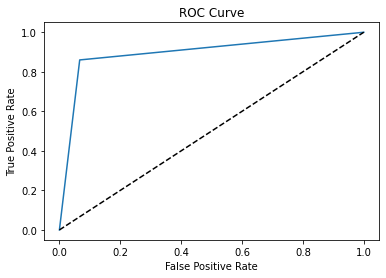

In [102]:
#Plot an Roc Curve
fpr, tpr, thresholds = roc_curve(y_test, probs)
plt.plot(fpr, tpr, label=f'ROC = {roc_auc_score(y_test, probs):.3f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

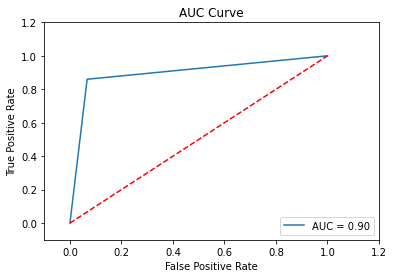

In [103]:
#Plot an AUC Curve
auc(fpr, tpr)
#plot it
plt.plot(fpr, tpr, label='AUC = %0.2f'% auc(fpr, tpr))
plt.legend(loc='lower right')
plt.plot([0,1],[0,1],'r--')
plt.xlim([-0.1,1.2])
plt.ylim([-0.1,1.2])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.title('AUC Curve')
plt.show()

### Summary of the models

In [104]:
df = pd.DataFrame({
    'model': ['log reg', 'xgboost', 'svm', 'random forest', 'log reg', 'xgboost', 'svm', 'random forest'],
    'metric': ['precision', 'precision', 'precision', 'precision', 'recall', 'recall', 'recall', 'recall'],
    'value': [0.9, 0.8, 0.7, 0.85, 0.85, 0.9, 0.75, 0.8]
})

# pivot table to reshape data frame
pivoted_df = df.pivot_table(index='model', columns='metric', values='value')

# display pivoted data frame
print(pivoted_df)

metric         precision  recall
model                           
log reg             0.90    0.85
random forest       0.85    0.80
svm                 0.70    0.75
xgboost             0.80    0.90


# 8 Submission Set<a class="anchor" id="Submission-Set"></a>

The selected model for this project is **Random Forest** since it got the best AUC ROC which allowed us to have a better prediction on the binary class for this problem.

We are going to apply the same transforations to the submission set as the one on the new traing set.

In [105]:
test_set = pd.read_csv('test.csv')

In [106]:
for col in object_col:
    print(f'{col}: {test_set[col].unique()}')

BusinessTravel: ['Non-Travel' 'Travel_Rarely' 'Travel_Frequently']
Department: ['Research & Development' 'Sales' 'Human Resources']
Education: [1 4 3 2 5]
EducationField: ['Medical' 'Marketing' 'Life Sciences' 'Technical Degree' 'Other'
 'Human Resources']
EnvironmentSatisfaction: [4 3 2 1 0]
Gender: ['Male' 'Female']
JobInvolvement: [3 2 4 1 0]
JobLevel: [1 2 3 5 4]
JobRole: ['Laboratory Technician' 'Sales Executive' 'Research Scientist'
 'Healthcare Representative' 'Manager' 'Human Resources'
 'Sales Representative' 'Manufacturing Director' 'Research Director']
JobSatisfaction: [3 1 4 2]
MaritalStatus: ['Single' 'Divorced' 'Married']
Over18: ['Y']
OverTime: ['No' 'Yes']
PerformanceRating: [3 4]
RelationshipSatisfaction: [4 3 2 1]
StockOptionLevel: [0 1 2 3 4]
WorkLifeBalance: [2 3 4 1]


In [107]:
test_set[test_set['JobInvolvement'] == 0]

,id,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
833,2510,51,Travel_Frequently,1096,Sales,2,3,Marketing,1,3,Male,90,0,2,Sales Executive,4,Married,6500,24668,5,Y,No,15,3,4,80,0,6,2,1,5,0,0,1


In [108]:
test_set.loc[833, 'JobInvolvement'] = 1

In [109]:
test_set[test_set['EnvironmentSatisfaction'] == 0]

,id,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
748,2425,28,Travel_Rarely,734,Research & Development,9,3,Medical,1,0,Female,64,3,1,Laboratory Technician,1,Single,2321,9150,9,Y,Yes,11,3,2,80,0,2,4,3,1,0,0,0


In [110]:
test_set.loc[748, 'EnvironmentSatisfaction'] = 1

In [111]:
test_set[test_set['StockOptionLevel'] == 4]

,id,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
577,2254,40,Travel_Rarely,1224,Research & Development,4,1,Life Sciences,1,3,Female,45,3,3,Healthcare Representative,4,Married,7756,22266,2,Y,Yes,14,3,1,80,4,10,5,3,5,4,1,4


In [112]:
test_set.loc[577, 'StockOptionLevel'] = 3

In [113]:
Predictions_id = pd.DataFrame(test_set['id'])

#Adding the Overall_satisfaction column
test_set['Overall_Satisfaction'] =  (test_set['EnvironmentSatisfaction'] + test_set['JobSatisfaction'] + 
                                  test_set['RelationshipSatisfaction'])
#Adjusting Categorical Values
test_set[to_categorical] = test_set[to_categorical].astype('str')

drop = ['Over18', 'EmployeeCount', 'StandardHours', 'id', 'DailyRate','HourlyRate' ]

test_set = test_set.drop(labels =  drop, axis =1)

test_set['BusinessTravel'] = test_set['BusinessTravel'].map({'Travel_Frequently': 'BussTrvl_Frequently', 
                                             'Travel_Rarely': 'BussTrvl_Rately', 
                                             'Non-Travel': 'BussTrvl_None' 
                                                      })

test_set['Department'] = test_set['Department'].map({'Research & Development': 'Dept_R&D', 
                                             'Sales': 'Dept_Sales', 
                                             'Human Resources': 'Dept_HHRR'
                                              }) 

test_set['EducationField'] = test_set['EducationField'].map({'Medical': 'EduFld_Med', 
                                                       'Other': 'EduFld_Othr',
                                                       'Marketing': 'EduFld_Mark',
                                                       'Life Sciences': 'EduFld_LSC', 
                                                       'Technical Degree': 'EduFld_TechDeg',
                                                       'Human Resources': 'EduFld_HHRR'
                                                      }) 

test_set['JobRole'] = test_set['JobRole'].map({'Laboratory Technician': 'JbRo_LabTech', 
                                         'Sales Representative': 'JbRo_SalesRep',
                                         'Sales Executive': 'JbRo_SalesExc',
                                         'Healthcare Representative': 'JbRo_HCRep',
                                         'Manager': 'JbRo_Mang',
                                         'Manufacturing Director': 'JbRo_ManDir',
                                         'Research Scientist': 'JbRo_RSc',
                                         'Human Resources': 'JbRo_HHRR',
                                         'Research Director': 'JbRo_ResDir',}) 

test_set['MaritalStatus'] = test_set['MaritalStatus'].map({'Married': 'MartStat_Marr', 
                                             'Divorced': 'MartStat_Div', 
                                             'Single': 'MartStat_Sing'
                                                    }) 

test_set['OverTime'] = test_set['OverTime'].map({'Yes': 'OverT_Yes',
                                           'No': 'OverT_No'
                                          }) 


test_set['Education'] = test_set['Education'].map({'3': 'Edu_Bachellor', 
                                             '4': 'Edu_Master', 
                                             '1': 'Edu_Below_Coll', 
                                             '2': 'Edu_College', 
                                             '5': 'Edu_Doctor'})

test_set['EnvironmentSatisfaction'] = test_set['EnvironmentSatisfaction'].map({'3': 'EnvSat_High',
                                                       '1': 'EnvSat_Low', 
                                                       '2': 'EnvSat_Medium',
                                                       '4': 'EnvSat_Very_High'})

test_set['JobInvolvement'] = test_set['JobInvolvement'].map({'3': 'JobInv_High',
                                                       '1': 'JobInv_Low', 
                                                       '2': 'JobInv_Medium',
                                                       '4': 'JobInv_Very_High'})
test_set['JobSatisfaction'] = test_set['JobSatisfaction'].map({'3': 'JobSat_High',
                                                       '1': 'JobSat_Low', 
                                                       '2': 'JobSat_Medium',
                                                       '4': 'JobSat_Very_High'})

test_set['PerformanceRating'] = test_set['PerformanceRating'].map({'3': 'PerfRat_Excellent',
                                                       '1': 'PerfRat_Low', 
                                                       '2': 'PerfRat_Good',
                                                       '4': 'PerfRat_Outstanding',})
test_set['RelationshipSatisfaction'] = test_set['RelationshipSatisfaction'].map({'3': 'RelSat_High',
                                                       '1': 'RelSat_Low', 
                                                       '2': 'RelSat_Medium',
                                                       '4': 'RelSat_Very_High'})

test_set['WorkLifeBalance'] = test_set['WorkLifeBalance'].map({'3': 'WLB_Better',
                                                       '1': 'WLB_Bad', 
                                                       '2': 'WLB_Good',
                                                       '4': 'WLB_Best'})

test_set['StockOptionLevel'] = test_set['StockOptionLevel'].map({'0': 'SOL_0',
                                                       '1': 'SOL_1', 
                                                       '2': 'SOL_2',
                                                       '3': 'SOL_3'})

test_set['JobLevel'] = test_set['JobLevel'].map({'1': 'JL_1',
                                                       '2': 'JL_2', 
                                                       '3': 'JL_3',
                                                       '4': 'JL_4',
                                                       '5': 'JL_5'})

test_set['YrsPerCompany'] = (test_set['TotalWorkingYears'] - test_set['YearsAtCompany']) / test_set['NumCompaniesWorked']
test_set.loc[(test_set['TotalWorkingYears'] == 0) | (test_set['NumCompaniesWorked'] == 0), 'YrsPerCompany'] = test_set['YearsAtCompany']

#One Hot Encoding

cat_data = test_set.select_dtypes("O")
cat_data_columns = test_set.select_dtypes("O").columns
cat_data_ohe = ohe.transform(cat_data)
np.concatenate(ohe.categories_, axis=0 )

cat_data_ohe = pd.DataFrame(cat_data_ohe)
cat_data_ohe.columns = np.concatenate(ohe.categories_, axis=0 )

test_set = pd.concat([test_set, cat_data_ohe], axis=1)

test_set = test_set.drop(cat_data_columns, axis =1)

#Standar Scaling of the Data

Num_Var=test_set[['Age','DistanceFromHome','MonthlyIncome','MonthlyRate','NumCompaniesWorked','PercentSalaryHike','TotalWorkingYears','TrainingTimesLastYear','YearsInCurrentRole','YearsSinceLastPromotion','YearsWithCurrManager']]
train_sc = scl.transform(Num_Var)

# the result is returned as a numpy array, so let's convert it again to a Padnas Df
train_sc = pd.DataFrame(train_sc, columns=Num_Var.columns)

test_set = test_set.drop(columns=['Age','DistanceFromHome','MonthlyIncome','MonthlyRate','NumCompaniesWorked','PercentSalaryHike','TotalWorkingYears','TrainingTimesLastYear','YearsInCurrentRole','YearsSinceLastPromotion','YearsWithCurrManager'], axis = 1)

test_set = pd.concat([test_set, train_sc], axis=1)

We are going to validate the transofmrations are according to expected results

In [114]:
test_set.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1119 entries, 0 to 1118
Data columns (total 78 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   YearsAtCompany           1119 non-null   int64  
 1   Overall_Satisfaction     1119 non-null   int64  
 2   YrsPerCompany            1119 non-null   float64
 3   BussTrvl_Frequently      1119 non-null   float64
 4   BussTrvl_None            1119 non-null   float64
 5   BussTrvl_Rately          1119 non-null   float64
 6   Dept_HHRR                1119 non-null   float64
 7   Dept_R&D                 1119 non-null   float64
 8   Dept_Sales               1119 non-null   float64
 9   Edu_Bachellor            1119 non-null   float64
 10  Edu_Below_Coll           1119 non-null   float64
 11  Edu_College              1119 non-null   float64
 12  Edu_Doctor               1119 non-null   float64
 13  Edu_Master               1119 non-null   float64
 14  EduFld_HHRR             

In [115]:
predicts = pd.DataFrame( clf_rf_pruned.predict(test_set))

In [116]:
predicts

,0
0,0.294373
1,0.099423
2,0.186627
3,0.157900
4,0.563432
...,...
1114,0.224731
1115,0.053343
1116,0.079342
1117,0.046942


In [117]:
submission = pd.merge(Predictions_id, predicts, left_index= True, right_index= True)

In [118]:
submission['Attrition'] = (submission[0] >= optimal_threshold).astype(int)

In [119]:
submission[['id','Attrition']].to_csv('predictions_group_2.csv', index = False)

In [120]:
submission['Attrition'].sum()

101

# Anexes

#### Profiling of the Employees

100%|██████████| 8/8 [00:01<00:00,  7.33it/s]


Text(0, 0.5, 'Inertia score (SSE)')

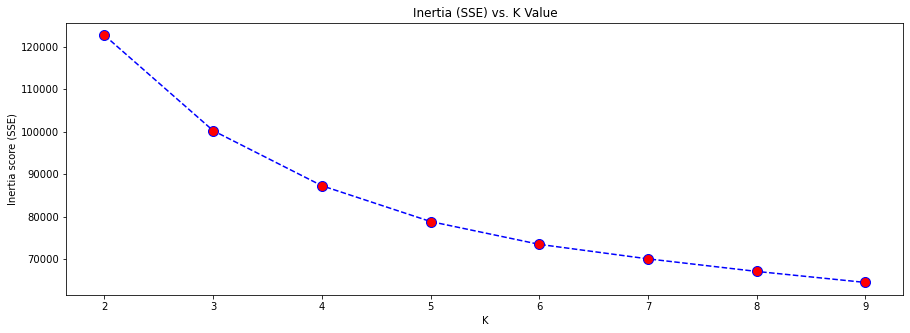

In [121]:
k1 = []
inertia_s1 = []

for i in tqdm(range(2,10)):
    k1.append(i)
    kmeans1 = KMeans(n_clusters=i,random_state=125,max_iter=100).fit(new_train)
    inertia_s1.append(kmeans1.inertia_)

plt.figure(figsize=(15,5))
plt.plot(k1,inertia_s1,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='red', markersize=10)
plt.title('Inertia (SSE) vs. K Value')
plt.xlabel('K')
plt.ylabel('Inertia score (SSE)')

In [122]:
kmeans = KMeans(n_clusters=4,random_state=125,max_iter=100).fit(new_train)
#sscore = ss(df_clust,kmeans.labels_)
inertia= kmeans.inertia_

# add cluster labels to features dataset
new_train['cluster_ids'] = kmeans.labels_

# Overall level summary
df_profile_overall = new_train.describe().T

# using mean; use appropriate summarization (median, count, etc.) for each feature
df_profile_overall['Overall Dataset'] = df_profile_overall[['mean']]
df_profile_overall = df_profile_overall[['Overall Dataset']]

# Cluster ID level summary
df_cluster_summary = new_train.groupby('cluster_ids').describe().T.reset_index()
df_cluster_summary = df_cluster_summary.rename(columns={'level_0':'column','level_1':'metric'})

# using mean; use appropriate summarization (median, count, etc.) for each feature
df_cluster_summary = df_cluster_summary[df_cluster_summary['metric'] == "mean"]
df_cluster_summary = df_cluster_summary.set_index('column')

# join into single summary dataset
df_profile = df_cluster_summary.join(df_profile_overall) # joins on Index

In [123]:
df_profile.T

column,YearsAtCompany,Overall_Satisfaction,YrsPerCompany,BussTrvl_Frequently,BussTrvl_None,BussTrvl_Rately,Dept_HHRR,Dept_R&D,Dept_Sales,Edu_Bachellor,Edu_Below_Coll,Edu_College,Edu_Doctor,Edu_Master,EduFld_HHRR,EduFld_LSC,EduFld_Mark,EduFld_Med,EduFld_Othr,EduFld_TechDeg,EnvSat_High,EnvSat_Low,EnvSat_Medium,EnvSat_Very_High,Female,Male,JobInv_High,JobInv_Low,JobInv_Medium,JobInv_Very_High,JL_1,JL_2,JL_3,JL_4,JL_5,JbRo_HCRep,JbRo_HHRR,JbRo_LabTech,JbRo_ManDir,JbRo_Mang,JbRo_RSc,JbRo_ResDir,JbRo_SalesExc,JbRo_SalesRep,JobSat_High,JobSat_Low,JobSat_Medium,JobSat_Very_High,MartStat_Div,MartStat_Marr,MartStat_Sing,OverT_No,OverT_Yes,PerfRat_Excellent,PerfRat_Outstanding,RelSat_High,RelSat_Low,RelSat_Medium,RelSat_Very_High,SOL_0,SOL_1,SOL_2,SOL_3,WLB_Bad,WLB_Best,WLB_Better,WLB_Good,Attrition,Age,DistanceFromHome,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,TotalWorkingYears,TrainingTimesLastYear,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
metric,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean
0,2.523575,7.692982,1.482008,0.208564,0.051732,0.739704,0.03551,0.676982,0.287508,0.461117,0.145983,0.181529,0.012371,0.199,0.013302,0.45081,0.113342,0.321787,0.040244,0.060514,0.305532,0.232243,0.194293,0.267932,0.32512,0.67488,0.603317,0.095669,0.250157,0.050857,0.677023,0.245639,0.053144,0.011977,0.012217,0.046191,0.03551,0.30174,0.052985,0.015422,0.25751,0.010965,0.157346,0.122331,0.34601,0.191961,0.178149,0.28388,0.137314,0.400553,0.462134,0.677666,0.322334,0.864108,0.135892,0.291761,0.234302,0.210198,0.26374,0.608798,0.304256,0.057472,0.029474,0.061154,0.084372,0.654927,0.199547,0.58114,-0.206858,-0.038544,-0.357888,-0.008371,0.069035,0.029579,-0.402228,0.01024,-0.592912,-0.413879,-0.61041
1,20.821622,7.994595,0.759926,0.184998,0.064865,0.750138,0.032432,0.696857,0.270711,0.344219,0.100411,0.155362,0.069785,0.330223,0.021622,0.396484,0.096039,0.365984,0.030088,0.089783,0.262609,0.1843,0.26585,0.287241,0.401261,0.598739,0.709532,0.064923,0.139281,0.086265,0.036721,0.168815,0.242964,0.272747,0.278753,0.140371,0.010811,0.031948,0.103968,0.379769,0.054054,0.116575,0.152326,0.010178,0.307857,0.27582,0.155347,0.260976,0.174948,0.436861,0.388191,0.625216,0.374784,0.889824,0.110176,0.399893,0.140695,0.145946,0.313466,0.50909,0.407252,0.058975,0.024683,0.098453,0.058342,0.605411,0.237794,0.313514,1.095033,-0.050746,1.795292,0.161323,0.199197,-0.201923,2.068604,-0.113756,1.822419,1.913692,1.824867
2,8.456996,7.908858,0.867641,0.153804,0.054425,0.79177,0.014128,0.659218,0.326655,0.379274,0.131469,0.15357,0.017958,0.317729,0.003851,0.490669,0.095748,0.29881,0.042303,0.068619,0.285224,0.194429,0.218924,0.301423,0.328515,0.671485,0.612259,0.040063,0.252271,0.095407,0.285181,0.446929,0.209548,0.036534,0.021809,0.105547,0.014128,0.198647,0.115564,0.047576,0.153524,0.052349,0.285634,0.02703,0.298947,0.234846,0.148848,0.317359,0.158021,0.409322,0.432657,0.694716,0.305284,0.873851,0.126149,0.263258,0.232546,0.176066,0.32813,0.563381,0.3453,0.049899,0.041421,0.052124,0.066391,0.652934,0.228551,0.428755,0.127273,0.06426,0.238279,-0.029501,-0.010018,-0.007888,0.253639,-0.020904,0.700357,0.343032,0.718571
3,11.96988,8.337349,11.697135,0.19609,0.054217,0.749693,0.012048,0.550699,0.437253,0.430383,0.072289,0.13253,0.024096,0.340702,0.0,0.37397,0.231065,0.312734,0.056862,0.025369,0.295135,0.15824,0.265435,0.28119,0.438076,0.561924,0.580372,0.096778,0.248756,0.074093,0.091682,0.390155,0.339852,0.104023,0.074287,0.118729,0.006024,0.10241,0.114458,0.136142,0.072289,0.062886,0.379718,0.007345,0.298566,0.154873,0.177653,0.368908,0.168295,0.431757,0.399949,0.704919,0.295081,0.915663,0.0843

# Dash Board Link

https://lookerstudio.google.com/reporting/4e0f5a1c-3054-47a7-b792-51ea04c10714